<a href="https://colab.research.google.com/github/rezjaq/SVIP/blob/main/Week3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### **Praktikum**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Mengubah tingkat kecerahan citra
--------------------------------
Masukkan nilai kecerahan: 50


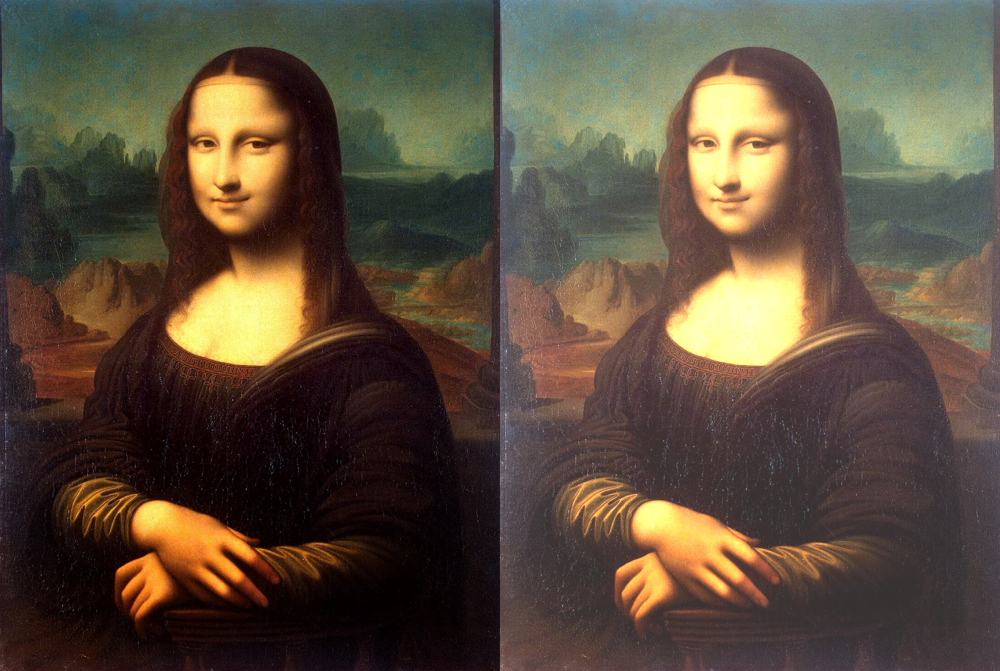

In [ ]:
import cv2 as cv  # Import OpenCV
import numpy as np  # Import NumPy
from google.colab.patches import cv2_imshow  # Required for displaying images in Google Colab

print('Mengubah tingkat kecerahan citra')
print('--------------------------------')

try:
    brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
    print('Error, not a number')

# Load the image
original = cv.imread('/content/drive/MyDrive/PCVK/monalisa.jpeg')

# Check if image was successfully loaded
if original is None:
    print("Error: Image not found or cannot be opened.")
else:
    # Create an empty image with the same size and type
    brightness_image = np.zeros(original.shape, original.dtype)

    # Adjust the brightness
    for y in range(original.shape[0]):
        for x in range(original.shape[1]):
            for c in range(original.shape[2]):
                brightness_image[y, x, c] = np.clip(original[y, x, c] + brightness, 0, 255)

    # Concatenate original and brightness-adjusted images
    final_frame = cv.hconcat([original, brightness_image])
    cv2_imshow(final_frame)


### **Tugas**

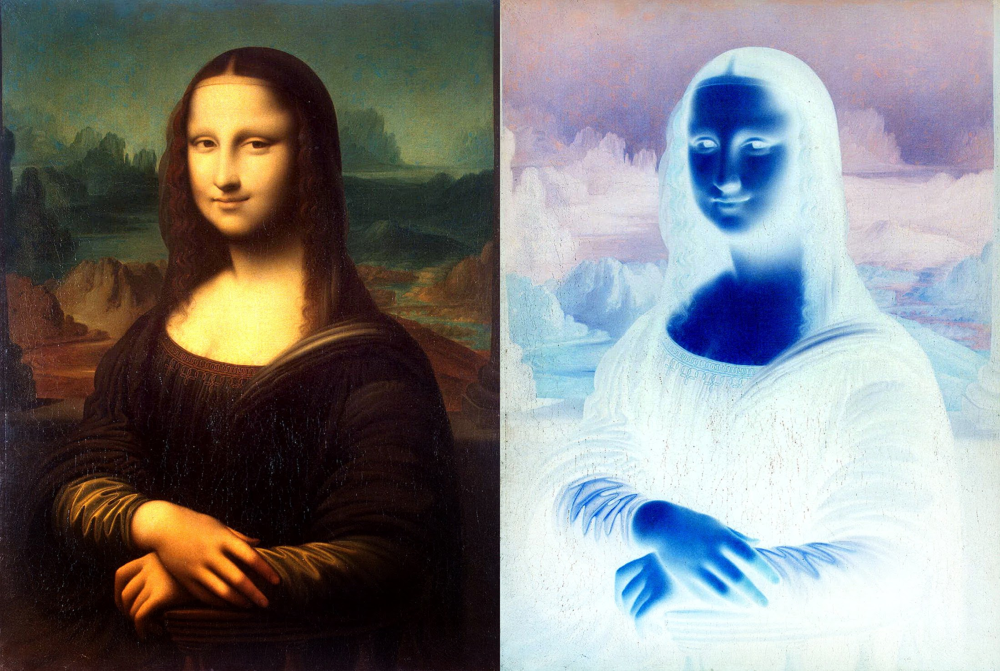

In [ ]:
# Load the original image
original = cv.imread('/content/drive/MyDrive/PCVK/monalisa.jpeg')

# Check if the image is loaded properly
if original is None:
    print("Error: Image not found.")
else:
    # Inverse the image by subtracting pixel values from 255
    inverted_image = 255 - original

    # Concatenate original and inverted images for side-by-side comparison
    comparison_image = cv.hconcat([original, inverted_image])

    # Display the original and inverted images
    cv2_imshow(comparison_image)

Mengubah kontras dan tingkat kecerahan citra
--------------------------------
Masukkan tingkat kecerahan [-255 - 255]: 50
Masukkan kontras [1.0 - 3.0]: 2


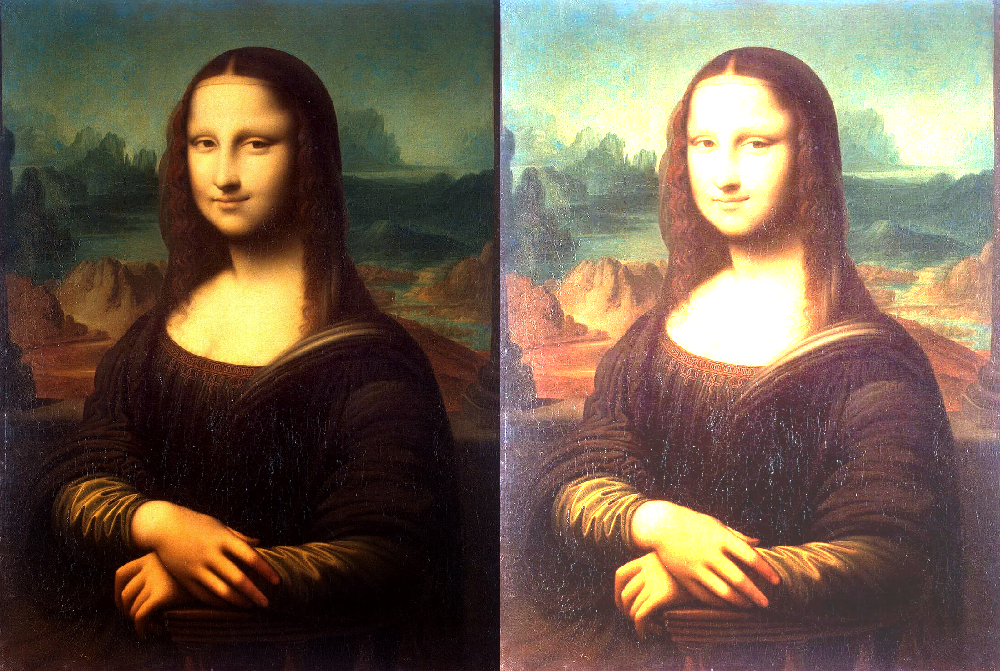

In [ ]:
print('Mengubah kontras dan tingkat kecerahan citra')
print('--------------------------------')
try:
    brightness = int(input('Masukkan tingkat kecerahan [-255 - 255]: '))
    contrast = float(input('Masukkan kontras [1.0 - 3.0]: '))
except ValueError:
    print('Error, input tidak valid')
    brightness = 0
    contrast = 1.0

original = cv.imread('/content/drive/MyDrive/PCVK/monalisa.jpeg')
if original is None:
    print('Error: Image not found')
    exit()

brightness_image = cv.convertScaleAbs(original, alpha=contrast, beta=brightness)
final_frame = cv.hconcat([original, brightness_image])
cv2_imshow(final_frame)

Mengubah tingkat kecerahan citra dengan Transformasi Log
--------------------------------
Masukkan nilai kecerahan: 50


<ipython-input-5-e61d992b47df>:15: RuntimeWarning: divide by zero encountered in log
  log_transformed = c * (np.log(1 + original + brightness))
<ipython-input-5-e61d992b47df>:17: RuntimeWarning: invalid value encountered in cast
  log_transformed = np.array(log_transformed, dtype=np.uint8)


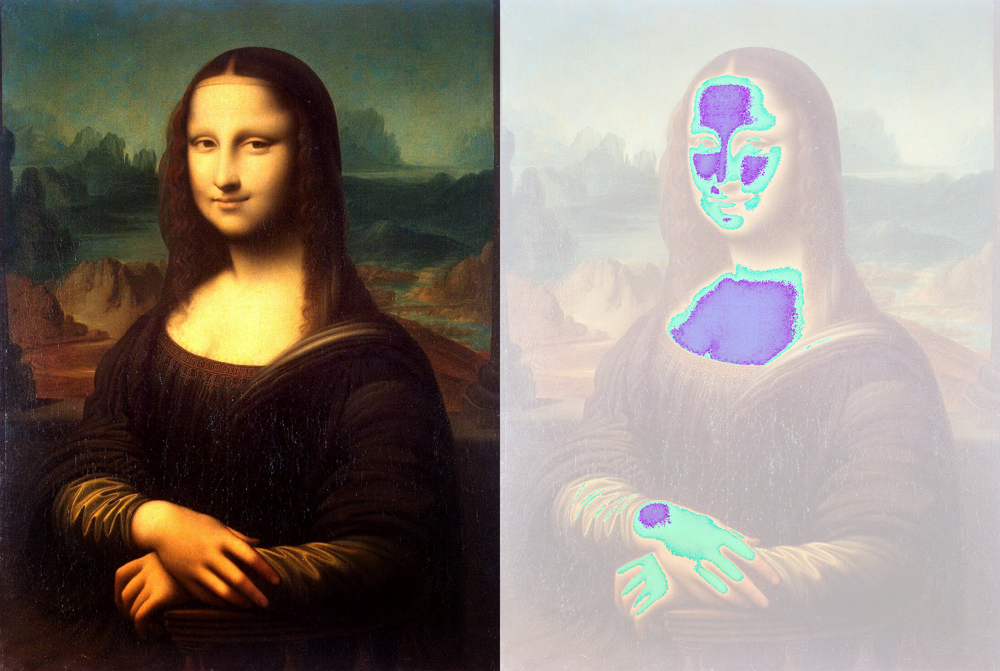

In [ ]:
print('Mengubah tingkat kecerahan citra dengan Transformasi Log')
print('--------------------------------')
try:
    brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
    print('Error, input tidak valid')
    brightness = 0

original = cv.imread('/content/drive/MyDrive/PCVK/monalisa.jpeg')
if original is None:
    print('Error: Image not found')
    exit()

c = 255 / np.log(1 + np.max(original))
log_transformed = c * (np.log(1 + original + brightness))

log_transformed = np.array(log_transformed, dtype=np.uint8)
final_frame = cv.hconcat([original, log_transformed])

# Tampilkan gambar
cv2_imshow(final_frame)

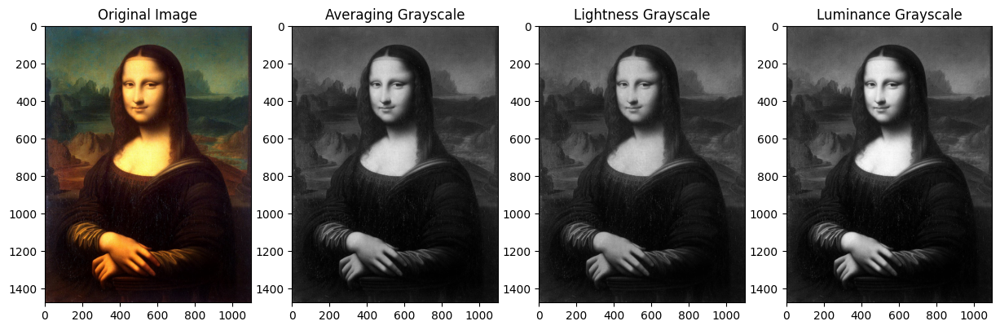

In [ ]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt

# Load the original image
original = cv.imread('/content/drive/MyDrive/PCVK/monalisa.jpeg')
image_rgb = cv.cvtColor(original, cv.COLOR_BGR2RGB)  # Convert BGR to RGB for Matplotlib

# Grayscale methods
averaging = np.mean(image_rgb, axis=2).astype(np.uint8)
lightness = np.mean([np.max(image_rgb, axis=2), np.min(image_rgb, axis=2)], axis=0).astype(np.uint8)
luminance = (0.299 * image_rgb[:, :, 0] + 0.587 * image_rgb[:, :, 1] + 0.114 * image_rgb[:, :, 2]).astype(np.uint8)

# Plotting
plt.figure(figsize=(15, 5))

# Original image
plt.subplot(1, 4, 1), plt.imshow(image_rgb), plt.title('Original Image'), plt.axis('on')

# Averaging
plt.subplot(1, 4, 2), plt.imshow(averaging, cmap='gray'), plt.title('Averaging Grayscale'), plt.axis('on')

# Lightness
plt.subplot(1, 4, 3), plt.imshow(lightness, cmap='gray'), plt.title('Lightness Grayscale'), plt.axis('on')

# Luminance
plt.subplot(1, 4, 4), plt.imshow(luminance, cmap='gray'), plt.title('Luminance Grayscale'), plt.axis('on')

plt.show()


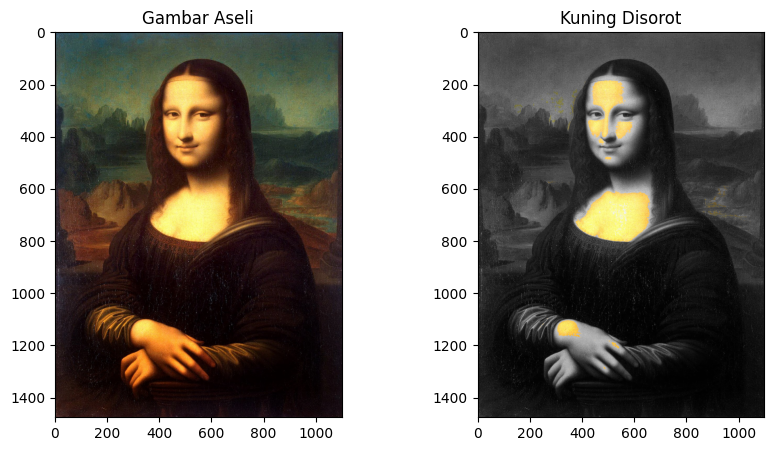

In [17]:
# Baca gambar asli
original = cv.imread('/content/drive/MyDrive/PCVK/monalisa.jpeg')

# Konversi gambar ke RGB
finimg = cv.cvtColor(original, cv.COLOR_BGR2RGB)

# Konversi gambar ke HSV
hsv = cv.cvtColor(original, cv.COLOR_BGR2HSV)

# Definisikan rentang warna kuning dalam ruang warna HSV
lower_yellow = np.array([20, 100, 100])
upper_yellow = np.array([30, 255, 255])

# Buat masker untuk warna kuning
mask = cv.inRange(hsv, lower_yellow, upper_yellow)

# Buat masker 3 channel
mask3 = np.zeros_like(original)
mask3[:, :, 0] = mask
mask3[:, :, 1] = mask
mask3[:, :, 2] = mask

# Ambil area kuning dari gambar
yellow_highlighted = cv.bitwise_and(finimg, mask3)

# Konversi gambar ke grayscale dan kembali ke RGB
gray = cv.cvtColor(finimg, cv.COLOR_RGB2GRAY)
finimg_gray = cv.cvtColor(gray, cv.COLOR_GRAY2RGB)

# Gabungkan gambar grayscale dan area kuning yang disorot menggunakan masker
gray_background = cv.bitwise_and(finimg_gray, cv.bitwise_not(mask3))
final_image = cv.add(gray_background, yellow_highlighted)

# Tampilkan gambar
plt.figure(figsize=(10, 5))

# Gambar asli
plt.subplot(1, 2, 1)
plt.imshow(finimg)
plt.title('Gambar Aseli')
plt.axis('on')

# Gambar dengan area kuning disorot
plt.subplot(1, 2, 2)
plt.imshow(final_image)
plt.title('Kuning Disorot')
plt.axis('on')

plt.show()
